# M-PHATE Demonstration
## Autoencoder (tensorflow)

In this notebook, we demonstrate the use of M-PHATE to visualize the evolution of a simple 3-layer autoencoder over the course of training.

### 1. Setup

In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

import scprep

import m_phate
import m_phate.train
import m_phate.data

Using TensorFlow backend.


Let's set the session so we can limit what percentage of the GPU is used, for courtesy's sake.

In [2]:
sess = tf.InteractiveSession(config=m_phate.train.build_config(limit_gpu_fraction=0.2))

Now we load MNIST in preprocessed form.

In [3]:
x_train, x_test, y_train, y_test = m_phate.data.load_mnist()

### 2. Build the neural network

In [4]:
# input layer
inputs = tf.keras.layers.Input(
    shape=(x_train.shape[1],), dtype='float32', name='inputs')

# three dense hidden layers
h1 = tf.keras.layers.Dense(64, name='h1')(inputs)
h2 = tf.keras.layers.Dense(64, name='h2')(tf.nn.leaky_relu(h1))
h3 = tf.keras.layers.Dense(64, name='h3')(tf.nn.leaky_relu(h2))

# output layer
outputs = tf.keras.layers.Dense(x_train.shape[1], activation='softmax', name='outputs')((tf.nn.leaky_relu(h3)))

# mean squared error loss
loss_op = tf.losses.mean_squared_error(inputs, outputs)
# binary crossentropy
entropy_op = tf.reduce_mean(tf.keras.backend.binary_crossentropy(inputs, outputs))

# build the optimizer
optimizer = tf.train.AdamOptimizer(1e-5)
train_op = optimizer.minimize(loss_op)

# initialize variables
_ = sess.run([tf.global_variables_initializer(), tf.local_variables_initializer()])

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


### 3. Set up the neural network trace

Here we randomly select ten examples of every digit from the test set - the hidden activations of these images will form our data tensor to be visualized.

In [5]:
np.random.seed(42)
# select the digit indices in the test set
trace_idx = []
for i in range(10):
    trace_idx.append(np.random.choice(np.argwhere(
        y_test[:, i] == 1).flatten(), 10, replace=False))

trace_idx = np.concatenate(trace_idx)
# extract the selected images
x_trace = x_test[trace_idx]

### 4. Train the network

In [6]:
# create a dictionary in which to store trace, loss, accuracy etc
history = {'trace':[], 'loss':[], 'val_loss':[], 'entropy':[], 'val_entropy':[]}

# train!
batch_size = 128
epochs = 200
verbose = False
for epoch in range(epochs):
    # randomize batch order
    batch_idx = np.random.choice(x_train.shape[0], x_train.shape[0], replace=False)
    
    # run minibatch training
    epoch_loss = []
    epoch_entropy = []
    for batch in range(x_train.shape[0] // batch_size):
        # get one batch worth of data
        x_batch = x_train[batch_idx[batch * batch_size:(batch + 1) * batch_size]]
        y_batch = y_train[batch_idx[batch * batch_size:(batch + 1) * batch_size]]
        # gradient step
        _, batch_loss, batch_entropy = sess.run([train_op, loss_op, entropy_op], 
                                            feed_dict={inputs : x_batch})
        # store loss and accuracy
        epoch_loss.append(batch_loss)
        epoch_entropy.append(batch_entropy)

    # mean loss and accuracy for the epoch
    epoch_loss = np.mean(epoch_loss)
    epoch_entropy = np.mean(epoch_entropy)
    history['loss'].append(epoch_loss)
    history['entropy'].append(epoch_entropy)
    
    # validation loss and accuracy
    epoch_val_loss, epoch_val_entropy = sess.run([loss_op, entropy_op], 
                                              feed_dict={inputs : x_test})
    history['val_loss'].append(epoch_val_loss)
    history['val_entropy'].append(epoch_val_entropy)
    
    if verbose:
        print("Epoch {}/{}:\tloss={:.3f}\tval_loss={:.3f}\tentropy={:.3f}\tval_entropy={:.3f}".format(
            epoch, epochs, epoch_loss, epoch_val_loss, epoch_entropy, epoch_val_entropy))
    
    # store the activations of the trace data
    epoch_trace = sess.run([h1, h2, h3],
                          feed_dict={inputs : x_trace})
    epoch_trace = np.concatenate([layer_trace.T for layer_trace in epoch_trace])
    history['trace'].append(epoch_trace)

### 5. Retrieve the output

There are a lot of metadata features we might be interested in visualizing, so we show you all of them here.

The most important element here is the first: the `n_epochs x n_neurons x n_examples` tensor. We often refer to the _flattened tensor_ as this is what will be returned by M-PHATE: this is the `n_epochs*n_neurons x n_dim` matrix to be visualized.

In [7]:
# the actual data tensor
trace_data = np.array(history['trace'])
n_epochs = trace_data.shape[0]
n_neurons = trace_data.shape[1]

# the train loss for each element of the flattened trace
loss = np.repeat(history['loss'], n_neurons)
# the validation loss for each element of the flattened trace
val_loss = np.repeat(history['val_loss'], n_neurons)
# the train accuracy for each element of the flattened trace
entropy = np.repeat(history['entropy'], n_neurons)
# the validation accuracy for each element of the flattened trace
val_entropy = np.repeat(history['val_entropy'], n_neurons)

# the unique neuron id for each element of the flattened trace
neuron_ids = np.tile(np.arange(n_neurons), n_epochs)
# the hidden layer that each element of the flattened trace belongs to
layer_ids = np.tile(np.concatenate([np.repeat(i, int(layer.shape[1]))
                                    for i, layer in enumerate([h1, h2, h3])]),
                    n_epochs)
# the current epoch for each element of the flattened trace
epoch = np.repeat(np.arange(n_epochs), n_neurons)

# the label of each digit we selected: this should be the same as `np.repeat(np.arange(10), 10)`
digit_ids = y_test.argmax(1)[trace_idx]
# normalize the data
trace_data_norm = m_phate.utils.normalize(trace_data)
# the average activity over digit labels for each element of the flattened trace
digit_activity = np.array([np.sum(np.abs(trace_data_norm[:, :, digit_ids == digit]), axis=2)
                           for digit in np.unique(digit_ids)])
# the digit label with the highest average activity for each element of the flattened trace
most_active_digit = np.argmax(digit_activity, axis=0).flatten()

### 6. Visualize the data tensor

Calculating M-PHATE...
  Calculating multislice kernel...
  Calculated multislice kernel in 10.27 seconds.
  Calculating graph and diffusion operator...
    Calculating landmark operator...
      Calculating SVD...
      Calculated SVD in 9.41 seconds.
      Calculating KMeans...
      Calculated KMeans in 82.67 seconds.
    Calculated landmark operator in 96.73 seconds.
  Calculated graph and diffusion operator in 97.36 seconds.
  Running PHATE on precomputed affinity matrix with 38400 cells.
  Calculating optimal t...
    Automatically selected t = 31
  Calculated optimal t in 38.79 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 20.86 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 248.81 seconds.
Calculated M-PHATE in 416.14 seconds.


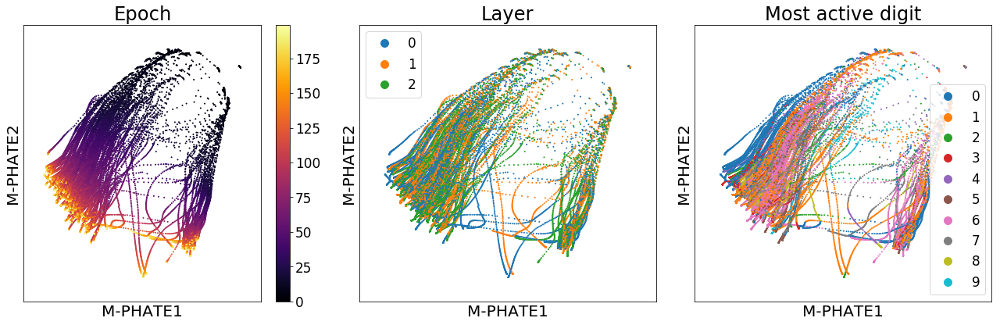

In [8]:
# calculate M-PHATE
m_phate_op = m_phate.M_PHATE()
m_phate_data = m_phate_op.fit_transform(trace_data)

# plot the results
plt.rc('font', size=14)
fig, (ax1, ax2, ax3) = plt.subplots(
    1, 3, figsize=(18, 6), sharex='all', sharey='all')
scprep.plot.scatter2d(m_phate_data, c=epoch, ax=ax1, ticks=False,
                      title='Epoch', label_prefix="M-PHATE")
scprep.plot.scatter2d(m_phate_data, c=layer_ids, ax=ax2, title='Layer',
                      ticks=False, label_prefix="M-PHATE")
scprep.plot.scatter2d(m_phate_data, c=most_active_digit, ax=ax3,
                      title='Most active digit',
                      ticks=False, label_prefix="M-PHATE")
plt.tight_layout()

Here we see the network begins with all hidden units looking approximately identical in the bottom right. As time progresses (see the left-hand plot) we see the hidden units split into two groups. If we color these units by hidden layer (center) we see that the units are not separating by layer; that is, there are hidden units in all three layers playing similar roles. We can also color the units by their _most active digit_; that is, when averaging the activations of units across all the dimensions of the trace corresponding to each specific digit label, which of these labels has the highest average activation (in absolute value). Once again, while we see some structure here (in that units that are close to one another tend to has the same most active digit) we see this is not the driver of the split. If you have looked at the [classification notebook](https://nbviewer.jupyter.org/github/scottgigante/m-phate/blob/master/examples/classification_tensorflow.ipynb), you'll notice that the digit structure is much clearer here - this is because the network is being forced to separate digits by class label.

Let's separate out the layers and see if there are any differences that we can't see when they are plotting all together.

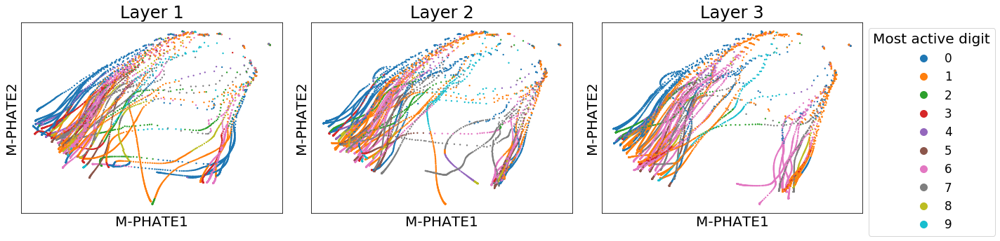

In [9]:
fig, axes = plt.subplots(1, 3, figsize=(20, 5))
for layer, ax in zip(range(3), axes.flatten()):
    scprep.plot.scatter2d(m_phate_data[layer_ids==layer], c=most_active_digit[layer_ids==layer], ax=ax,
                          title="Layer {}".format(layer+1), ticks=False, label_prefix="M-PHATE", legend=layer==2,
                         legend_anchor=(1,1), legend_title="Most active digit")
plt.tight_layout()

Interestingly, the small group of hidden units that separated from the rest is much less common in layer 1 than in the other layers. We can also color the units by their average activities over each digit label. We don't expect to see perfect separation here because an autoencoder shouldn't necessarily care about external labels, though digits with the same label should still for the most part look similar to one another.

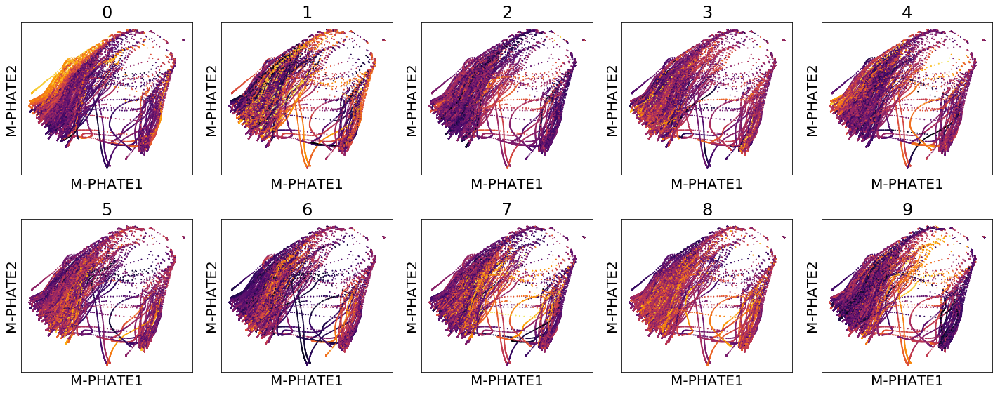

In [10]:
fig, axes = plt.subplots(2, 5, figsize=(20, 8))
for digit, ax in zip(range(10), axes.flatten()):
    scprep.plot.scatter2d(m_phate_data, c=digit_activity[digit].flatten(), ax=ax,
                          title=digit, ticks=False, label_prefix="M-PHATE", legend=False)
plt.tight_layout()

Finally, we can also visualize the network loss on this plot to see how the evolution corresponds with improvements in performance.

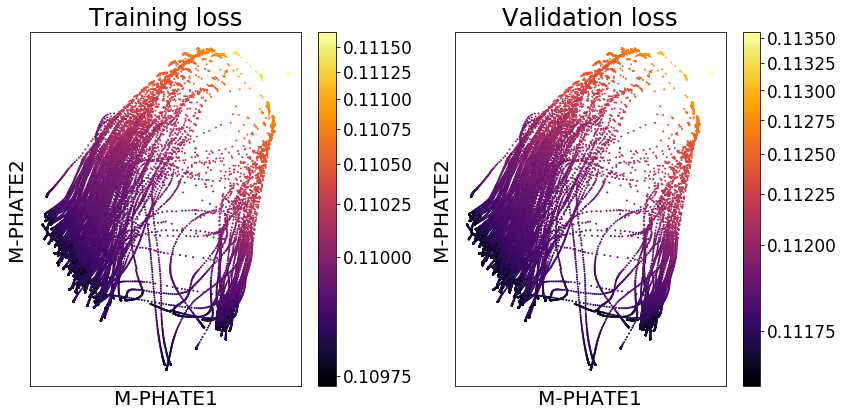

In [11]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
scprep.plot.scatter2d(m_phate_data, c=loss, ax=ax1, ticks=False, cmap_scale='sqrt',
                      title='Training loss', label_prefix="M-PHATE")
scprep.plot.scatter2d(m_phate_data, c=val_loss, ax=ax2, ticks=False, cmap_scale='sqrt',
                      title='Validation loss', label_prefix="M-PHATE")
plt.tight_layout()

### 7. Comparison to a deep network

Just running M-PHATE on one network doesn't really tell us much. Let's build another network with the same number of hidden units, but with a 'narrow and deep' architecture instead of a 'wide and shallow' architecture.

In [12]:
# input layer
inputs = tf.keras.layers.Input(
    shape=(x_train.shape[1],), dtype='float32', name='inputs')

# three dense hidden layers
h1 = tf.keras.layers.Dense(32, name='h1')(inputs)
h2 = tf.keras.layers.Dense(32, name='h2')(tf.nn.leaky_relu(h1))
h3 = tf.keras.layers.Dense(32, name='h3')(tf.nn.leaky_relu(h2))
h4 = tf.keras.layers.Dense(32, name='h4')(tf.nn.leaky_relu(h3))
h5 = tf.keras.layers.Dense(32, name='h5')(tf.nn.leaky_relu(h4))
h6 = tf.keras.layers.Dense(32, name='h6')(tf.nn.leaky_relu(h5))

# output layer
outputs = tf.keras.layers.Dense(x_train.shape[1], activation='softmax', name='outputs')((tf.nn.leaky_relu(h6)))

# mean squared error loss
loss_op = tf.losses.mean_squared_error(inputs, outputs)
# binary crossentropy
entropy_op = tf.reduce_mean(tf.keras.backend.binary_crossentropy(inputs, outputs))

# build the optimizer
optimizer = tf.train.AdamOptimizer(1e-5)
train_op = optimizer.minimize(loss_op)

# initialize variables
_ = sess.run([tf.global_variables_initializer(), tf.local_variables_initializer()])

# create a dictionary in which to store trace, loss, accuracy etc
history = {'trace':[], 'loss':[], 'val_loss':[], 'entropy':[], 'val_entropy':[]}

# train!
batch_size = 128
epochs = 200
verbose = False
for epoch in range(epochs):
    # randomize batch order
    batch_idx = np.random.choice(x_train.shape[0], x_train.shape[0], replace=False)
    
    # run minibatch training
    epoch_loss = []
    epoch_entropy = []
    for batch in range(x_train.shape[0] // batch_size):
        # get one batch worth of data
        x_batch = x_train[batch_idx[batch * batch_size:(batch + 1) * batch_size]]
        y_batch = y_train[batch_idx[batch * batch_size:(batch + 1) * batch_size]]
        # gradient step
        _, batch_loss, batch_entropy = sess.run([train_op, loss_op, entropy_op], 
                                            feed_dict={inputs : x_batch})
        # store loss and accuracy
        epoch_loss.append(batch_loss)
        epoch_entropy.append(batch_entropy)

    # mean loss and accuracy for the epoch
    epoch_loss = np.mean(epoch_loss)
    epoch_entropy = np.mean(epoch_entropy)
    history['loss'].append(epoch_loss)
    history['entropy'].append(epoch_entropy)
    
    # validation loss and accuracy
    epoch_val_loss, epoch_val_entropy = sess.run([loss_op, entropy_op], 
                                              feed_dict={inputs : x_test})
    history['val_loss'].append(epoch_val_loss)
    history['val_entropy'].append(epoch_val_entropy)
    
    if verbose:
        print("Epoch {}/{}:\tloss={:.3f}\tval_loss={:.3f}\tentropy={:.3f}\tval_entropy={:.3f}".format(
            epoch, epochs, epoch_loss, epoch_val_loss, epoch_entropy, epoch_val_entropy))
    
    # store the activations of the trace data
    epoch_trace = sess.run([h1, h2, h3, h4, h5, h6],
                          feed_dict={inputs : x_trace})
    epoch_trace = np.concatenate([layer_trace.T for layer_trace in epoch_trace])
    history['trace'].append(epoch_trace)
    
# the actual data tensor
deep_trace_data = np.array(history['trace'])

# the hidden layer that each element of the flattened trace belongs to
deep_layer_ids = np.tile(np.concatenate([np.repeat(i, int(layer.shape[1]))
                                    for i, layer in enumerate([h1, h2, h3, h4, h5, h6])]),
                    n_epochs)

In [13]:
# calculate M-PHATE
m_phate_deep_op = m_phate.M_PHATE()
m_phate_deep_data = m_phate_deep_op.fit_transform(deep_trace_data)

Calculating M-PHATE...
  Calculating multislice kernel...
  Calculated multislice kernel in 10.55 seconds.
  Calculating graph and diffusion operator...
    Calculating landmark operator...
      Calculating SVD...
      Calculated SVD in 7.91 seconds.
      Calculating KMeans...
      Calculated KMeans in 65.05 seconds.
    Calculated landmark operator in 77.11 seconds.
  Calculated graph and diffusion operator in 77.66 seconds.
  Running PHATE on precomputed affinity matrix with 38400 cells.
  Calculating optimal t...
    Automatically selected t = 30
  Calculated optimal t in 36.15 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 17.56 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 248.95 seconds.
Calculated M-PHATE in 390.91 seconds.


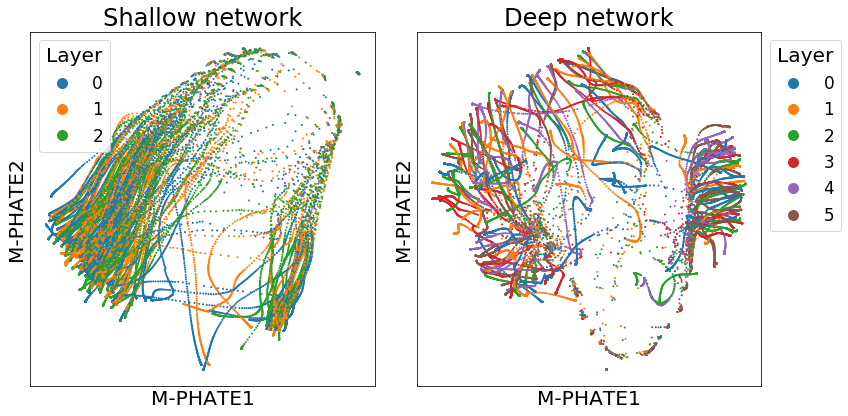

In [14]:
fig, (ax1, ax2) = plt.subplots(1,2,figsize=(12,6))
scprep.plot.scatter2d(m_phate_data, c=layer_ids, ax=ax1,
                      title='Shallow network',
                      ticks=False, label_prefix="M-PHATE",
                      legend_title='Layer')
scprep.plot.scatter2d(m_phate_deep_data, c=deep_layer_ids, ax=ax2,
                      title='Deep network',
                      ticks=False, label_prefix="M-PHATE",
                      legend_title='Layer', legend_anchor=(1,1))
plt.tight_layout()

The deep network has far more structure than the shallow network, indicating that it is forming much more complex abstract features. In fact, it appears this structure might be so complex that it is not embedding well in 2D, as you can see from the plot folding over itself.

### 8. Plot in 3D

To increase the degrees of freedom, we can plot M-PHATE in 3D. Sometimes you can see structure more clearly this way.

In [15]:
# do it in 3D!
m_phate_deep_op.set_params(n_components=3)
m_phate_deep_data = m_phate_deep_op.transform()

Calculating metric MDS...
Calculated metric MDS in 358.33 seconds.


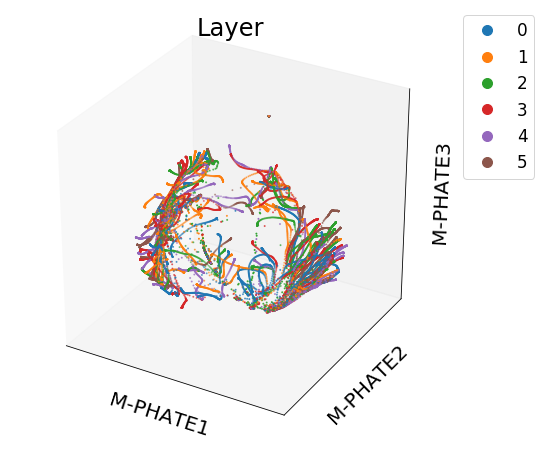

In [16]:
scprep.plot.scatter3d(m_phate_deep_data, c=deep_layer_ids,
                      title='Layer',
                      ticks=False, label_prefix="M-PHATE",
                      figsize=(8,8), legend_anchor=(1.2,1))

In [17]:
# rotating plot can be saved as a gif or mp4
scprep.plot.rotate_scatter3d(m_phate_deep_data, c=deep_layer_ids,
                             title='Layer', figsize=(10,8),
                             ticks=False, label_prefix="M-PHATE",
                             legend_anchor=(1.05, 1),
                             #filename='deep3d.gif', fps=25, rotation_speed=60,
                             )